In [974]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings("ignore")
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap, MarkerCluster

In [975]:
data = pd.read_csv("/home/vitormuniz/Documentos/data/acidentes/cat_acidentes.csv", sep=";")

In [976]:
data

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2025-09-01 01:33:25,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2025-09-01 01:33:25,598.0,0.0,2020-01-01 00:00:00,1,0,0,0,0,0,...,NaN,NaN,AV BENTO GONCALVES,NaN,ABALROAMENTO,QUARTA-FEIRA,03:00:00.0000000,NOITE,LESTE,NaN
2,2025-09-01 01:33:25,1271.0,0.0,2020-01-01 00:00:00,1,1,0,0,0,1,...,NaN,NaN,AV INDEPENDENCIA,NaN,ATROPELAMENTO,QUARTA-FEIRA,23:00:00.0000000,NOITE,LESTE,NaN
3,2025-09-01 01:33:25,1901.0,0.0,2020-01-02 00:00:00,2,0,0,0,0,0,...,NaN,NaN,AV EDUARDO PRADO,NaN,ATROPELAMENTO,QUINTA-FEIRA,00:05:00.0000000,NOITE,SUL,NaN
4,2025-09-01 01:33:25,3302.0,0.0,2020-01-02 00:00:00,1,0,0,0,0,1,...,-51.211535,-30.081535,AV TERESOPOLIS,NaN,ABALROAMENTO,QUINTA-FEIRA,09:00:00.0000000,DIA,SUL,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75171,2025-09-01 01:33:25,680.0,0.0,2025-07-03 00:00:00,0,0,0,0,0,2,...,-51.213184,-30.049725,AV AZENHA,NaN,COLISÃO,QUINTA-FEIRA,16:30:00.0000000,DIA,LESTE,NaN
75172,2025-09-01 01:33:25,421.0,0.0,2025-07-03 00:00:00,0,0,0,0,0,1,...,-51.204159,-30.033800,R CABRAL,R MARIANTE,COLISÃO,QUINTA-FEIRA,18:15:00.0000000,NOITE,LESTE,NaN
75173,2025-09-01 01:33:25,1024.0,0.0,2025-07-07 00:00:00,0,0,0,0,0,1,...,-51.248341,-30.099139,AV WENCESLAU ESCOBAR,NaN,COLISÃO,SEGUNDA-FEIRA,09:10:00.0000000,DIA,SUL,NaN
75174,2025-09-01 01:33:25,1039.0,0.0,2025-07-07 00:00:00,0,0,0,0,0,1,...,-51.230281,-30.093377,R SANTA FLORA,NaN,COLISÃO,SEGUNDA-FEIRA,13:35:00.0000000,DIA,SUL,NaN


In [977]:
# Mostrando as informações dos dados
data.info()

<class 'pandas.DataFrame'>
RangeIndex: 75176 entries, 0 to 75175
Data columns (total 34 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   data_extracao  75176 non-null  str    
 1   predial1       70715 non-null  float64
 2   queda_arr      75176 non-null  float64
 3   data           75176 non-null  str    
 4   feridos        75176 non-null  int64  
 5   feridos_gr     75176 non-null  int64  
 6   mortes         75176 non-null  int64  
 7   morte_post     75176 non-null  int64  
 8   fatais         75176 non-null  int64  
 9   auto           75176 non-null  int64  
 10  taxi           75176 non-null  int64  
 11  lotacao        75176 non-null  int64  
 12  onibus_urb     75176 non-null  int64  
 13  onibus_met     75176 non-null  int64  
 14  onibus_int     75176 non-null  int64  
 15  caminhao       75176 non-null  int64  
 16  moto           75176 non-null  int64  
 17  carroca        75176 non-null  int64  
 18  bicicleta      75

In [978]:
# Mostrando as estatísticas dos dados
data.describe()

,predial1,queda_arr,feridos,feridos_gr,mortes,morte_post,fatais,auto,taxi,lotacao,...,moto,carroca,bicicleta,outro,cont_vit,ups,patinete,idacidente,longitude,latitude
count,7.071500e+04,75176.000000,75176.000000,75176.000000,75176.000000,75176.000000,75176.000000,75176.000000,75176.000000,75176.000000,...,75176.000000,75176.000000,75176.000000,75176.000000,75176.00000,75176.000000,75176.000000,75176.000000,64580.000000,64580.000000
mean,1.761212e+03,0.000372,0.445435,0.077538,0.003086,0.002714,0.005800,1.436057,0.013182,0.006225,...,0.323401,0.000266,0.020113,0.000612,0.38229,2.573960,0.000652,719080.316896,-50.725793,-29.779233
std,6.618613e+03,0.019296,0.659939,0.290935,0.058045,0.052531,0.079194,0.759471,0.114754,0.078825,...,0.498024,0.016309,0.141801,0.025783,0.48595,2.087143,0.026038,33470.052938,4.816518,2.827850
min,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.00000,1.000000,0.000000,190816.000000,-51.265854,-30.242610
25%,2.000000e+02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.00000,1.000000,0.000000,688118.750000,-51.212701,-30.065245
50%,7.770000e+02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.00000,1.000000,0.000000,717028.500000,-51.189427,-30.037994
75%,2.205000e+03,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,1.00000,5.000000,0.000000,745802.250000,-51.153935,-30.017000
max,1.097024e+06,1.000000,34.000000,5.000000,3.000000,2.000000,4.000000,10.000000,2.000000,2.000000,...,4.000000,1.000000,2.000000,2.000000,1.00000,13.000000,2.000000,774504.000000,0.000000,0.000000


In [979]:
# Contagem de nulos por coluna
data.isnull().sum()

data_extracao        0
predial1          4461
queda_arr            0
data                 0
feridos              0
feridos_gr           0
mortes               0
morte_post           0
fatais               0
auto                 0
taxi                 0
lotacao              0
onibus_urb           0
onibus_met           0
onibus_int           0
caminhao             0
moto                 0
carroca              0
bicicleta            0
outro                0
cont_vit             0
ups                  0
patinete             0
idacidente           0
longitude        10596
latitude         10596
log1                53
log2             54523
tipo_acid            0
dia_sem              0
hora               629
noite_dia            0
regiao               1
consorcio        72766
dtype: int64

ETL para ajustar termos geograficos

In [980]:
# Tratando coordenadas 0 como NaN
data['latitude'] = data['latitude'].replace(0, np.nan)
data['longitude'] = data['longitude'].replace(0, np.nan)

In [981]:
# Preencher coordenadas faltantes, ou seja, onde latitude e longitude estão nulas
mapa_rua_log1 = (
    data
    .dropna(subset=["log1", "latitude", "longitude"])
    .drop_duplicates(subset=["log1"])
    .set_index("log1")[["latitude", "longitude"]]
)

mask = data["latitude"].isna() | data["longitude"].isna()

data.loc[mask, "latitude"] = data.loc[mask, "log1"].map(mapa_rua_log1["latitude"])
data.loc[mask, "longitude"] = data.loc[mask, "log1"].map(mapa_rua_log1["longitude"])


In [982]:
# Preencher coordenadas faltantes, ou seja, onde latitude e longitude estão nulas
mapa_rua_log2 = (
    data
    .dropna(subset=["log2", "latitude", "longitude"])
    .drop_duplicates(subset=["log2"])
    .set_index("log2")[["latitude", "longitude"]]
)

mask = data["latitude"].isna() | data["longitude"].isna()

data.loc[mask, "latitude"] = data.loc[mask, "log2"].map(mapa_rua_log2["latitude"])
data.loc[mask, "longitude"] = data.loc[mask, "log2"].map(mapa_rua_log2["longitude"])

In [983]:
# Contagem de nulos por coluna
data.isnull().sum()

data_extracao        0
predial1          4461
queda_arr            0
data                 0
feridos              0
feridos_gr           0
mortes               0
morte_post           0
fatais               0
auto                 0
taxi                 0
lotacao              0
onibus_urb           0
onibus_met           0
onibus_int           0
caminhao             0
moto                 0
carroca              0
bicicleta            0
outro                0
cont_vit             0
ups                  0
patinete             0
idacidente           0
longitude         3845
latitude          3845
log1                53
log2             54523
tipo_acid            0
dia_sem              0
hora               629
noite_dia            0
regiao               1
consorcio        72766
dtype: int64

In [984]:
# Removendo registros que não da para mapear
data = data.dropna(subset=["latitude", "longitude", "regiao"])

In [985]:
# Removendo colunas auxiliares usadas para preencher coordenadas
data = data.drop(columns=["log1", "log2", "predial1"])

ETL para ajustar a coluna hora

In [986]:
# Diagnóstico das linhas com hora nula 
data_hora_null = data[data["hora"].isna()]
data_hora_null["noite_dia"].unique()

<StringArray>
['NOITE']
Length: 1, dtype: str

In [987]:
# Converter 'hora' para inteiro
data["hora"] = pd.to_datetime(data["hora"], format='%H:%M:%S.%f', errors="coerce")
data['hora'] = np.round(data['hora'].dt.hour + data['hora'].dt.minute / 60).astype('Int64')

In [988]:
# Preencher valores nulos de horas com média arredondada do período "NOITE" 
data_hora_media = data[data['noite_dia'] == "NOITE"]
data_hora_media = np.round(data_hora_media["hora"].mean())
data["hora"] = data["hora"].fillna(data_hora_media)

In [989]:
# Contagem de nulos por coluna
data.isnull().sum()

data_extracao        0
queda_arr            0
data                 0
feridos              0
feridos_gr           0
mortes               0
morte_post           0
fatais               0
auto                 0
taxi                 0
lotacao              0
onibus_urb           0
onibus_met           0
onibus_int           0
caminhao             0
moto                 0
carroca              0
bicicleta            0
outro                0
cont_vit             0
ups                  0
patinete             0
idacidente           0
longitude            0
latitude             0
tipo_acid            0
dia_sem              0
hora                 0
noite_dia            0
regiao               0
consorcio        69061
dtype: int64

ETL da coluna consorcio

In [990]:
# Removendo a coluna consorcio
data = data.drop(columns=['consorcio'])

In [991]:
# Contagem de nulos por coluna
data.isnull().sum()

data_extracao    0
queda_arr        0
data             0
feridos          0
feridos_gr       0
mortes           0
morte_post       0
fatais           0
auto             0
taxi             0
lotacao          0
onibus_urb       0
onibus_met       0
onibus_int       0
caminhao         0
moto             0
carroca          0
bicicleta        0
outro            0
cont_vit         0
ups              0
patinete         0
idacidente       0
longitude        0
latitude         0
tipo_acid        0
dia_sem          0
hora             0
noite_dia        0
regiao           0
dtype: int64

Mapas de colisão na região de Porto Alegre

In [992]:
# Criando o mapa de calor
mapa = folium.Map(location=[-30.10, -51.15], zoom_start=10)
cordenadas = list(zip(data.latitude, data.longitude))
mapa_calor = HeatMap(cordenadas, radius=9, blur=10)
mapa.add_child(mapa_calor)

In [993]:
# Criando o mapa de cluster 
mapa = folium.Map(location=[-30.10, -51.15], zoom_start=10)
cordenadas = list(zip(data.latitude, data.longitude))
mapa_cluster = MarkerCluster(cordenadas)
mapa.add_child(mapa_cluster)

Fazendo análises de acidentes

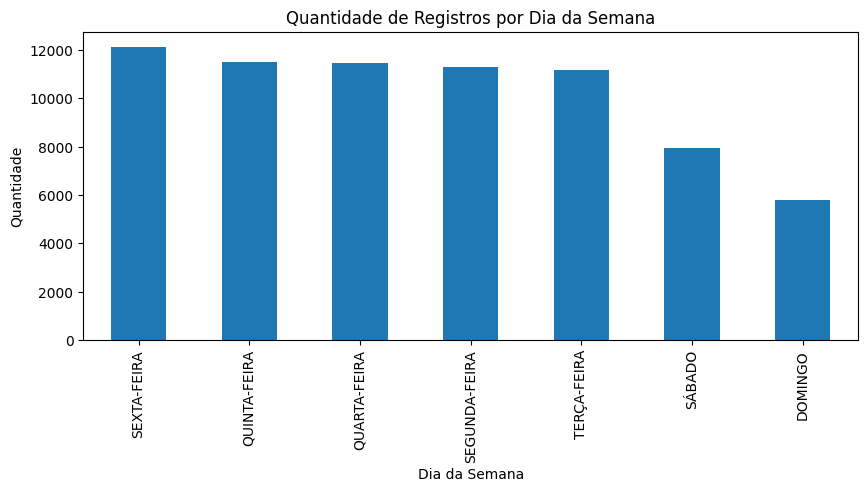

In [994]:
# Contando a ocorrências de acidentes
contagem_dia_sem = data['dia_sem'].value_counts()

# Plotando o grafico  de quantidade de registros de acidentes por dia da semana
plt.figure(figsize=(10, 4))
contagem_dia_sem.plot(kind='bar')
plt.title('Quantidade de Registros por Dia da Semana')
plt.xlabel('Dia da Semana')
plt.ylabel('Quantidade')

plt.show()

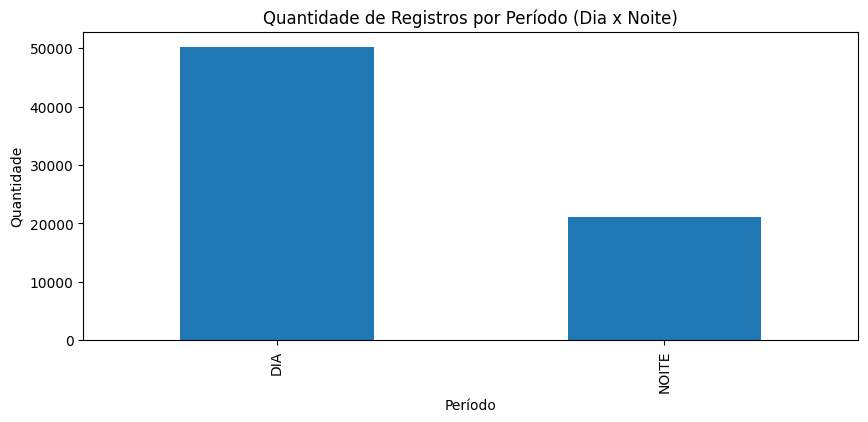

In [995]:
# Contando a ocorrências de acidentes
contagem_dia = data['noite_dia'].value_counts()

# Plotar o gráfico de quantidade de registros de acidentes por dia e noite
plt.figure(figsize=(10, 4))
contagem_dia.plot(kind='bar')
plt.title('Quantidade de Registros por Período (Dia x Noite)')
plt.xlabel('Período')
plt.ylabel('Quantidade')

plt.show()

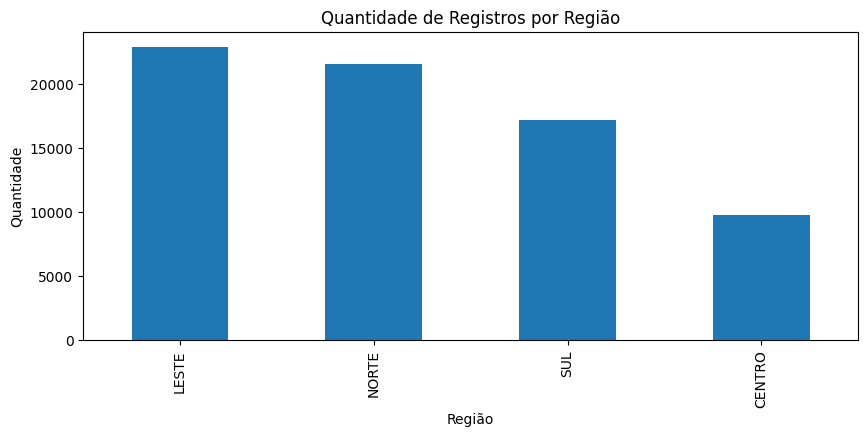

In [996]:
# Contando a ocorrências de acidentes
contagem_regiao = data['regiao'].value_counts()

# Plotar o gráfico de quantidade de registros de acidentes por região
plt.figure(figsize=(10, 4))
contagem_regiao.plot(kind='bar')
plt.title('Quantidade de Registros por Região')
plt.xlabel('Região')
plt.ylabel('Quantidade')

plt.show()

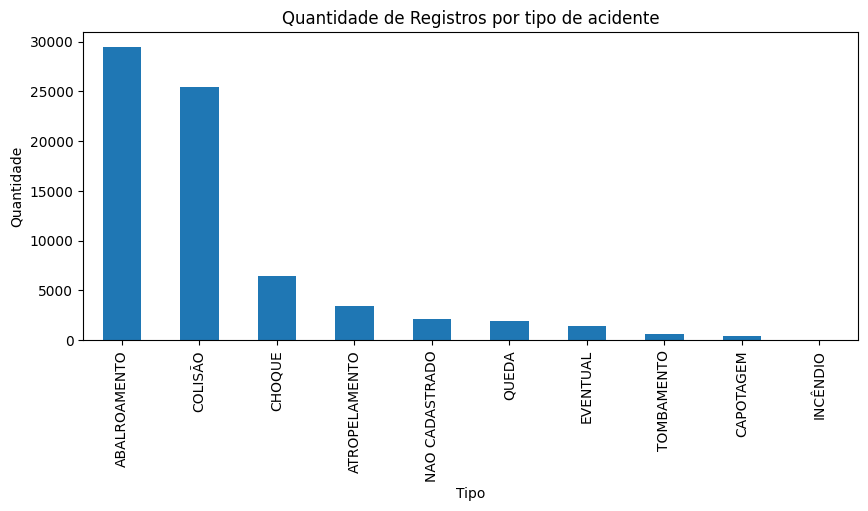

In [997]:
# Contando a ocorrências de acidentes
contagem_tipo = data['tipo_acid'].value_counts()

# Plotar o gráfico de quantidade de registros de acidentes por tipo
plt.figure(figsize=(10, 4))
contagem_tipo.plot(kind='bar')
plt.title('Quantidade de Registros por tipo de acidente')
plt.xlabel('Tipo')
plt.ylabel('Quantidade')

plt.show()

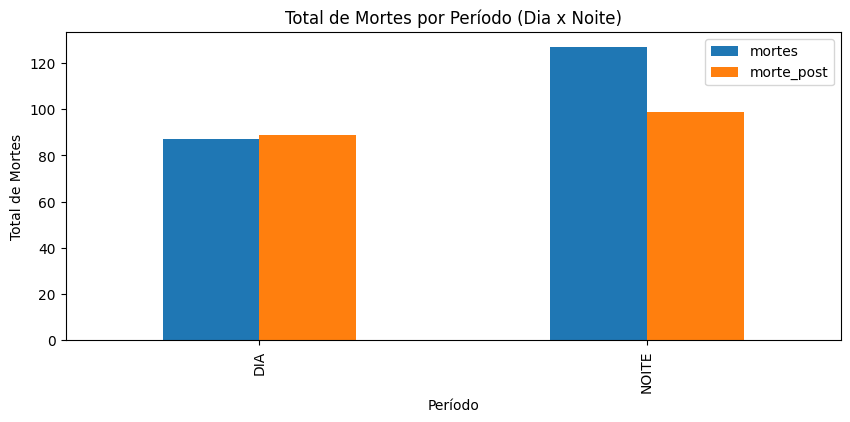

In [998]:
# Contando a ocorrências de acidentes fatais
soma_mortes = (data.groupby('noite_dia')[['mortes', 'morte_post']].sum())

# Plotar o gráfico de quantidade de mortes por dia e noite
fig, ax = plt.subplots(figsize=(10, 4))
soma_mortes.plot(kind='bar', ax=ax)
ax.set_title('Total de Mortes por Período (Dia x Noite)')
ax.set_xlabel('Período')
ax.set_ylabel('Total de Mortes')

plt.show()

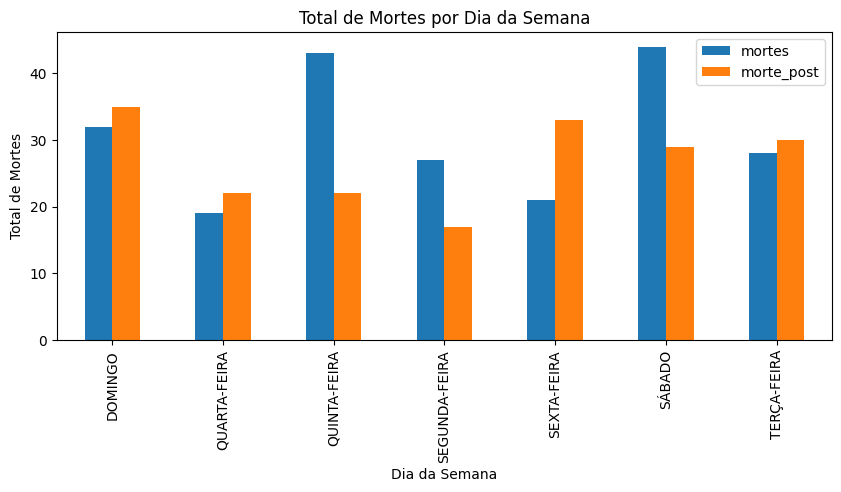

In [999]:
# Contando a ocorrências de acidentes fatais
soma_mortes_dia_sem = (data.groupby('dia_sem')[['mortes', 'morte_post']].sum())

# Plotar o gráfico de quantidade de registros de acidentes por dia da semana
fig, ax = plt.subplots(figsize=(10, 4))
soma_mortes_dia_sem.plot(kind='bar', ax=ax)
ax.set_title('Total de Mortes por Dia da Semana')
ax.set_xlabel('Dia da Semana')
ax.set_ylabel('Total de Mortes')

plt.show()

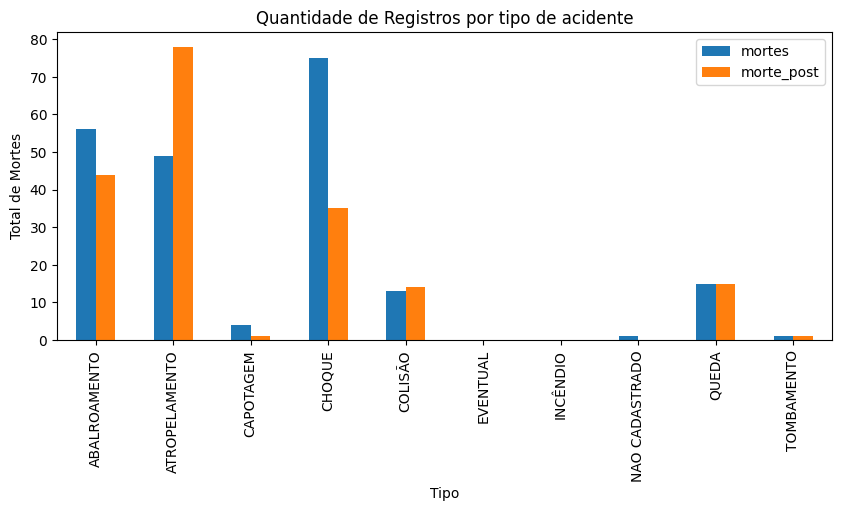

In [1000]:
# Contando a ocorrências de acidentes fatais
soma_mortes_tipo = (data.groupby('tipo_acid')[['mortes', 'morte_post']].sum())

# Plotar o gráfico de quantidade de registros de acidentes por tipo
fig, ax = plt.subplots(figsize=(10, 4))
soma_mortes_tipo.plot(kind='bar', ax=ax)
ax.set_title('Quantidade de Registros por tipo de acidente')
ax.set_xlabel('Tipo')
ax.set_ylabel('Total de Mortes')

plt.show()